# UFRJ Analytica - Processo Seletivo 2022

Por Marcos Eduardo

## Introdução

O Citi Bike é um sistema público de compartilhamento de bicicletas de propriedade privada que atende os bairros de Nova York do Bronx, Brooklyn, Manhattan e Queens, bem como Jersey City e etc. Foi inaugurado oficialmente em maio de 2013 com 332 estações e 6.000 bicicletas. Nessa análise nós iremos lidar com os dados do ano de 2019.

## Levantamento de perguntas


Antes de analisar os dados, vamos começar fazendo algumas perguntas que talvez queiramos entender sobre o funcionamento do share bike. Podemos nos perguntar que tipos de informações gostaríamos de conhecer para tomar decisões mais mais inteligentes? Além disso, se formos usuários do serviço, quais fatores podem influenciar em nosso usar do serviço?

Possíveis perguntas:

* Como é distribuido o tempo de uso das biciletas.
* Quais os meses com viagems mais duradouras.
* Como é a distrubioção do uso das bicicletas por idade e gênero.
* Quais os horário de maior demanda.
* Qual dia da semana de maior deamanda.
* Quem são os tipos de usuários com duração de viagem mais longas.
* Quais são as 10 Estações mais ultilizadas.
* Estações com mais usuários assinante.
* Quais as rotas mais realizadas.
* Usuários que fazem corridas paralelas.

## Descrição das Features

O nosso conjunto de dados é descrito da seguinte forma:

|Atributo                                           |   Descrição   |
|---------------------------------------------------|:-------------:|
| tripduration                                      |   Duração da viagem em segundos | 
| starttime                                         |   Início da viagem | 
| stoptime                                          |   Fim da Viagem   | 
| start station id                                  |   ID da estação origem   | 
| start station name                                |   Nome da estação onde a viagem começou|
| start station latitude / start station longitude  |   Localização onde a viagem começou|
| end station id                                    |   ID da estação destino   | 
| end station name                                  |   Nome da estação onde a viagem terminou|
| end station latitude /end station longitude       |   Localização onde a viagem terminou   |
| Bike ID                                           |   ID da bicicleta  |
| usertype                                          |   Customer = passe de 24 horas ou 3 dias; Subscriber = Membro Anual |
| birth year                                        |   Ano de nascimento|
| gender                                            |   0 = desconhecido; 1 = masculino; 2 = feminino |


Os dados foram retirados do kaggle: [New York City Bike Share Dataset](https://www.kaggle.com/datasets/akkithetechie/new-york-city-bike-share-dataset).

In [2]:
import numpy as np 
import pandas as pd 
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt
import sys
import plotly.graph_objects as go

## Análise Prelimiar

### Limpeza e Tratamento de Dados

In [3]:
#importar dados
df = pd.read_csv('data_bike2019.csv')
df.describe()

,tripduration,start station id,start station latitude,start station longitude,end station id,end station latitude,end station longitude,bikeid,birth year,gender
count,4.049470e+05,404947.000000,404947.000000,404947.000000,404947.000000,404947.000000,404947.000000,404947.000000,404947.000000,404947.000000
mean,7.258427e+02,3294.022391,40.722722,-74.046333,3292.219142,40.722328,-74.045792,28465.511998,1981.417524,1.162335
std,9.785237e+03,171.021930,0.007037,0.010871,180.886426,0.006885,0.010829,1654.373618,10.257440,0.516120
min,6.100000e+01,3183.000000,40.709651,-74.083639,116.000000,40.695065,-74.083639,14792.000000,1887.000000,0.000000
25%,2.330000e+02,3195.000000,40.718355,-74.050444,3192.000000,40.718355,-74.050389,26286.000000,1975.000000,1.000000
50%,3.450000e+02,3210.000000,40.721525,-74.043845,3207.000000,40.721124,-74.043117,29284.000000,1984.000000,1.000000
75%,5.800000e+02,3276.000000,40.727224,-74.038051,3276.000000,40.727224,-74.038051,29536.000000,1989.000000,1.000000
max,2.566420e+06,3792.000000,40.748716,-74.032108,3792.000000,40.814326,-73.932077,41913.000000,2003.000000,2.000000


Em uma análise parcial, podemos notar que o `birth year` possui um valor minimo fora do normal.

In [4]:
# Verificando tamanho
linhas, colunas = df.shape
print(f"Total de linhas: {linhas}\nTotal de colunas: {colunas}")

Total de linhas: 404947
Total de colunas: 15


Uma pequena amostro dos dados que estamos trabalhando.

In [5]:
df.sample(3)

,tripduration,starttime,stoptime,start station id,start station name,start station latitude,start station longitude,end station id,end station name,end station latitude,end station longitude,bikeid,usertype,birth year,gender
15509,329,2019-01-15 19:09:58.9160,2019-01-15 19:15:28.4330,3276,Marin Light Rail,40.714584,-74.042817,3639,Harborside,40.719252,-74.034234,26247,Subscriber,1990,1
364076,662,2019-11-08 16:51:22.2410,2019-11-08 17:02:25.2360,3225,Baldwin at Montgomery,40.723659,-74.064194,3186,Grove St PATH,40.719586,-74.043117,26205,Subscriber,1972,1
230133,281,2019-08-11 08:34:14.8110,2019-08-11 08:38:56.3780,3213,Van Vorst Park,40.718489,-74.047727,3278,Monmouth and 6th,40.725685,-74.048790,29550,Subscriber,1967,2


In [6]:
df.info() #Verificando tipo de dados

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 404947 entries, 0 to 404946
Data columns (total 15 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   tripduration             404947 non-null  int64  
 1   starttime                404947 non-null  object 
 2   stoptime                 404947 non-null  object 
 3   start station id         404947 non-null  int64  
 4   start station name       404947 non-null  object 
 5   start station latitude   404947 non-null  float64
 6   start station longitude  404947 non-null  float64
 7   end station id           404947 non-null  int64  
 8   end station name         404947 non-null  object 
 9   end station latitude     404947 non-null  float64
 10  end station longitude    404947 non-null  float64
 11  bikeid                   404947 non-null  int64  
 12  usertype                 404947 non-null  object 
 13  birth year               404947 non-null  int64  
 14  gend

In [7]:
print(f"Total de linhas duplicadas: {df.duplicated().sum()}") # Verificando existencia de linhas duplicadas
df = df.drop_duplicates() # Remoção das duplicatas

Total de linhas duplicadas: 0


In [8]:
df.isnull().sum() # Verificando campos nulos

tripduration               0
starttime                  0
stoptime                   0
start station id           0
start station name         0
start station latitude     0
start station longitude    0
end station id             0
end station name           0
end station latitude       0
end station longitude      0
bikeid                     0
usertype                   0
birth year                 0
gender                     0
dtype: int64

In [9]:
df['bikeid'].count() # Total de usuarios que alugaram bicicletas em 2020

404947

#### Alterando os tipos de dados

In [10]:
# string para datatime
df['birth year'] = pd.to_numeric(df['birth year'], downcast='integer')
df['starttime'] = pd.to_datetime(df['starttime'])
df['stoptime'] = pd.to_datetime(df['stoptime'])
# integer para category
df['gender'] = df['gender'].astype('category')

### Calculando a idade

Como o nosso conjuneto de dados é do ano de 2019, usaremos esse ano como base das idades.

In [11]:
df['age'] = 2019-df['birth year']

## Análise Exploratória

Temos `40.4947` usuários que alugaram bicicletas em 2019. A viagem mais longa foi de `2.566.420` segundos.


### Extraindo dia, dias da semana e hora do dataset

In [12]:
df['start_month'] = df['starttime'].dt.month_name()        #Extraindo mês
df['start_hours'] = df['starttime'].dt.hour                # Extraindo hora
df['start_weekday'] = df['starttime'].dt.weekday           # Extraindo dia da semana 
df['start_weekday_name'] = df['starttime'].dt.day_name()   # Extraindo nome do dia da semana
df['tripduration_in_min'] = df['tripduration'].apply(lambda x: round(x/60))     # Criando duração em minutos

### Duração da Viagem

In [13]:
desc = df['tripduration'].describe()
desc

count    4.049470e+05
mean     7.258427e+02
std      9.785237e+03
min      6.100000e+01
25%      2.330000e+02
50%      3.450000e+02
75%      5.800000e+02
max      2.566420e+06
Name: tripduration, dtype: float64

A duração máxima de uma viagem com `2.566.420` segundos, não é atipica. Em um conversão rápida, temos `42.773` minutos e `712` horas.

In [14]:
# Calculando limite superior do boxplot
Q1 = desc[4]
Q3 = desc[6]
IQR = Q3-Q1
upper_bound = Q3 + 1.5*IQR
print(f"Limite Superior: {upper_bound}")

Limite Superior: 1100.5


##### Análise estatística

- Cerca de 75% do tempo, os ciclistas gastam em torno de `580` segundos ou `9,6` minutos na viagem
- Os ciclistas andam de bicicleta por pelo menos `61` segundos.
- Em média, `725,8` segundos, o que significa `12` minutos.

Vamos considerar nessa análise, que a `duração máxima` do uso das bicicletas não vão ultrapassar `24` horas.

In [15]:
# Verificando quantidade de viagens acima de 24horas
df[df['tripduration'] >=24*60*60].shape

(150, 21)

In [16]:
# Duração máxima de 1 dia
df = df[df['tripduration'] <=24*60*60]

### Verificando Estações

In [17]:
endStation = df[['end station name', 'end station longitude', 'end station latitude']].drop_duplicates()
startStation= df[['start station name', 'start station longitude', 'start station latitude']].drop_duplicates()

In [18]:
fig = px.scatter_mapbox(endStation, lat="end station latitude", lon="end station longitude", hover_name = "end station name",
                 width=900, height=600, zoom=12, mapbox_style="carto-positron")

fig.add_trace(go.Scattermapbox(
        lat=startStation['start station latitude'],
        lon=startStation['start station longitude'],
        mode='markers',
        name="start station name",
        marker=go.scattermapbox.Marker(
            size=5,
            color='rgb(0, 255,0)',
            opacity=0.7
        ),
        text=startStation['start station name'],
        hoverinfo='text'
    ))
fig.update_layout(
                    margin={"r":0,"t":0,"l":0,"b":0},
                    showlegend=False)
fig.show()

Nosso conjunto de dados foi fornecido para a `Jersey City`, logo as estações em `azul` não deveriam fazer parte do nosso conjuto. A estação de New York mais próxima de Jersey é a `West Thames St`, vamos usar sua longitude para remover individuos com a longetude menor.

In [19]:
df = df[df['end station longitude'] < -74.018]

Agora vamos verificar se existe uma mesma estação e local diferente

In [20]:
duplicate = df.groupby(['start station name','start station latitude', 'start station longitude']).size().reset_index(name='count')
duplicate['start station name'].duplicated().sum()

1

Vamos verificar qual estação é essa.

In [21]:
duplicate = df.groupby(['start station name','start station latitude', 'start station longitude', 'start station id']).size().reset_index(name='count')
duplicate[duplicate['start station name'].duplicated()]

,start station name,start station latitude,start station longitude,start station id,count
48,Sip Ave,40.730897,-74.063913,3195,16878


In [22]:
duplicate[duplicate['start station name'] == 'Sip Ave']

,start station name,start station latitude,start station longitude,start station id,count
47,Sip Ave,40.730743,-74.063784,3195,2192
48,Sip Ave,40.730897,-74.063913,3195,16878


In [23]:
# Removendo colunas desnecessárias
df.drop(['end station id', 'start station id'],axis=1,inplace=True)

## Distribuição duração viagem (tempo de uso)

Como vimos nosso limite superior é de `1100.5` segundos, ou seja, `18` minutos. Vamos vizualiar a distribuição do uso limitado em até `60` minutos.

In [24]:
# Tempo de uso em minutos com limitado em 60 min
fig = px.histogram(df, x="tripduration_in_min")
fig.update_layout(xaxis_range=[1,60])
fig.show()

###  Verificando idades dos clientes

In [25]:
df['age'].describe()

count    404634.000000
mean         37.580406
std          10.256020
min          16.000000
25%          30.000000
50%          35.000000
75%          44.000000
max         132.000000
Name: age, dtype: float64

Uma média de `37` anos, sendo o mais novo com 16 anos e o mais velho com 132 anos.

In [26]:
# Verificando quantidades de pessoas com mais de 100 anos
df[df['age'] > 100].shape[0]

196

Nosso limite superior para idade é de 65 anos, porem vamos permitir alguns outlirs. Limitando a idade em 70 anos.

In [27]:
#Removendo idade menores que 70
df = df[df['age'] <=70]

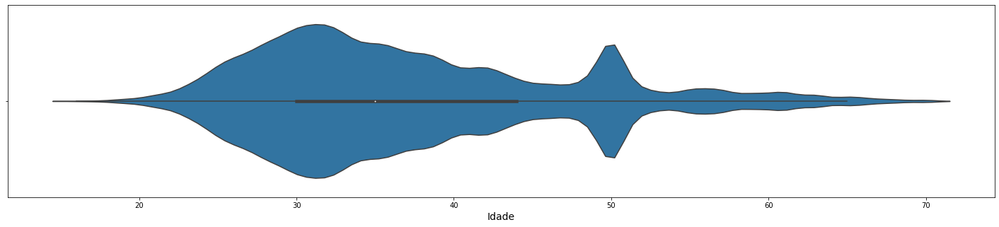

In [28]:
plt.figure(figsize = (25,5))
sns.violinplot(x='age', data=df)
plt.xlabel('Idade', fontsize=14)
plt.show()

### Média de viagens por idade

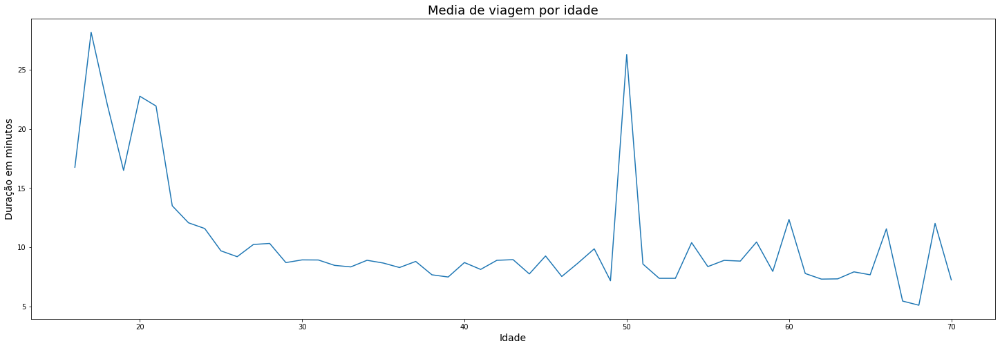

In [29]:
# Media de viagem por idade
plt.figure(figsize = (25,8))

plt.title('Media de viagem por idade', fontsize=18)
plt.xlabel('Idade', fontsize=14)
plt.ylabel('Duração em minutos', fontsize=14)

average_trip = df.groupby('age')['tripduration_in_min'].mean().reset_index().rename(columns={'age': 'idade', 'tripduration_in_min':'media'})
sns.lineplot(data =average_trip, x='idade', y='media')
plt.show()


### Dividindo as idades em grupos

In [30]:
df['ageGroup']= pd.cut(
   df['age'],
   bins=[0, 20, 30, 40, 50, 60, sys.maxsize],
   labels=['<20', '20-29', '30-39', '40-49', '50-59', '60+']
)

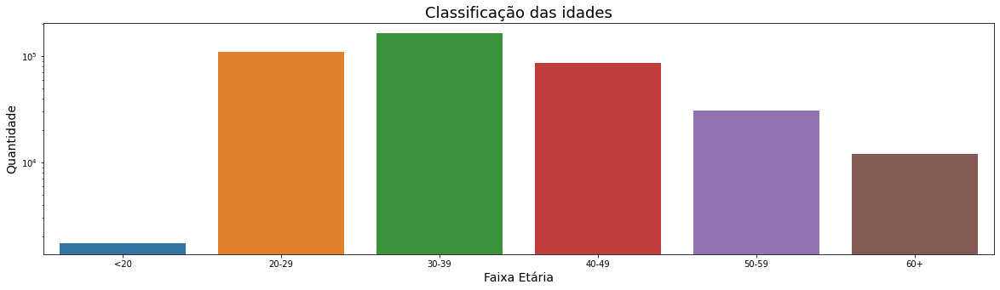

In [31]:
plt.figure(figsize = (20,5))
ax = sns.countplot(x=df["ageGroup"])
ax.get_figure().get_axes()[0].set_yscale('log')
plt.title('Classificação das idades', fontsize=18)
plt.xlabel('Faixa Etária', fontsize=14)
plt.ylabel('Quantidade', fontsize=14)
plt.show()

### Como é a proporção da idade por dia de semana?

In [32]:
weekOrder = ['Sunday', 'Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday']
fig = px.histogram(df, x="start_weekday_name",
             color='ageGroup', barmode='group',
             height=400, title='Idade x Dia da semana', log_y=True)
fig.update_xaxes(categoryorder='array', categoryarray= weekOrder)

fig.show()

Podemos notar que a concentração para todas as idades está nos finais de semana, cosequentemente podendo gerar um `pico` uma alta procura nesses dias.

## Média de duração do uso por mês

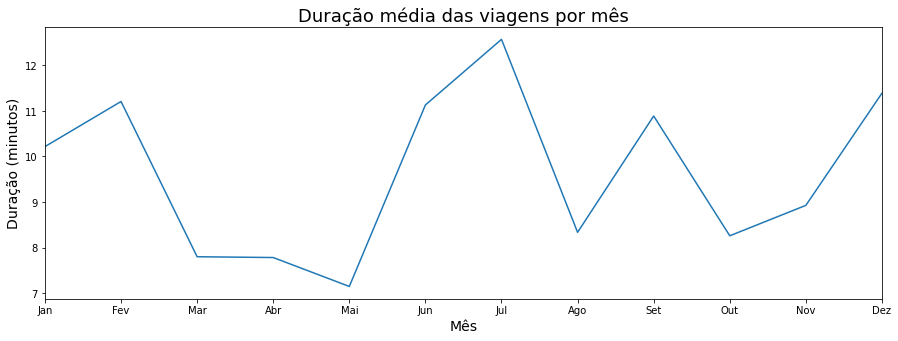

In [33]:
plt.figure(figsize = (15,5))

ax = df.groupby('start_month')['tripduration_in_min'].mean().plot()
ax.set_xlim(0, 11)
plt.xticks(range(0,12), ['Jan', 'Fev', 'Mar', 'Abr', 'Mai', 'Jun', 'Jul', 'Ago', 'Set', 'Out', 'Nov', 'Dez'])

plt.title('Duração média das viagens por mês', fontsize=18)
plt.xlabel('Mês', fontsize=14)
plt.ylabel('Duração (minutos)', fontsize=14)
plt.show()

O mês de `Julho` é o mês com as viagens médias mais longas, uma possivel justificativa para isso, pode ser por conta do feriado 4 julho que comemora a independência dos EUA.

In [34]:
july = df[df['start_month'] == 'July'].copy()
july['start_day']= july['starttime'].dt.day

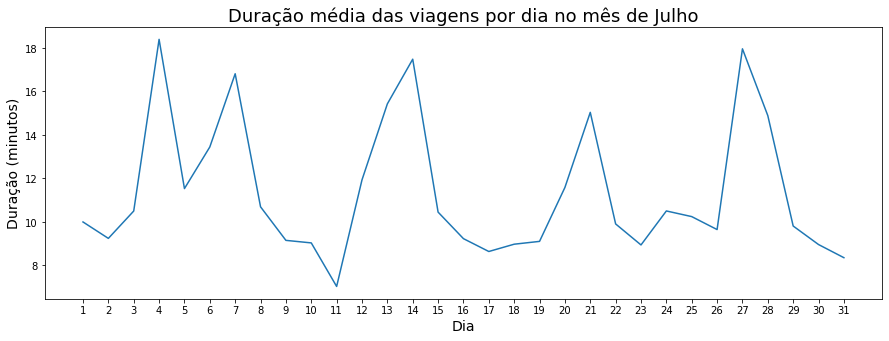

In [35]:
plt.figure(figsize = (15,5))
plt.xticks(range(1,32))

july.groupby('start_day')['tripduration_in_min'].mean().plot()

plt.title('Duração média das viagens por dia no mês de Julho', fontsize=18)
plt.xlabel('Dia', fontsize=14)
plt.ylabel('Duração (minutos)', fontsize=14)
plt.show()

Como deduzido, o dia 4 de julho foi o dia com maior duração média nas viagens.

## Tipos de clientes

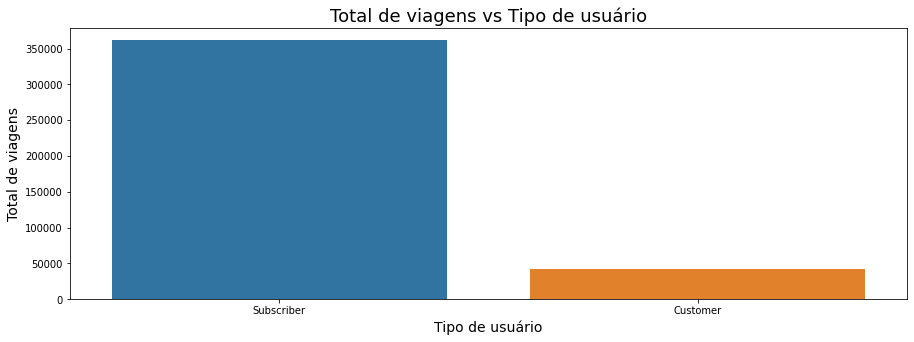

In [36]:
plt.figure(figsize = (15,5))
ax = sns.countplot(data= df, x = 'usertype', order = df['usertype'].value_counts().index)
plt.xlabel('Tipo de usuário', fontsize=14)
plt.ylabel('Total de viagens', fontsize=14)
plt.title('Total de viagens vs Tipo de usuário', fontsize=18)
plt.show()

## Proporção dos Gênero

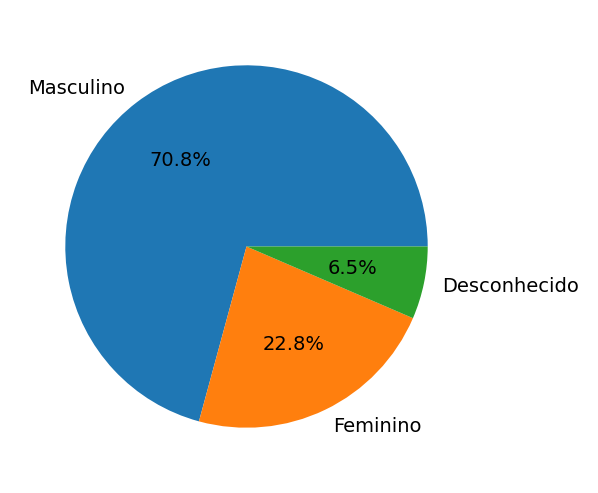

In [37]:
plt.figure(figsize=(3,3), dpi=200)
mylabels = ["Masculino", "Feminino", "Desconhecido"]
plt.pie(df['gender'].value_counts(), labels = mylabels, autopct='%1.1f%%', textprops={'fontsize': 7})
plt.show() 

### Relação Idade e Gênero

In [38]:
# Criando uma nova tabela com idade e gêneros
gender_age = pd.crosstab(index=df['gender'], columns=df['ageGroup'], rownames=['gender'], colnames=['Faixa Etaria'])
gender_age = pd.DataFrame(gender_age) 
gender_age = gender_age.rename(index={1: 'Masculino', 2: 'Feminino', 0: 'Desconhecido'}) #Adicionando nomes as linhas
gender_age = (gender_age / len(df)).round(2)

In [39]:
# Cada bloco mostra a porcentagem das viagens que foram feitas por essa idade + gênero
# Somando todas temos 1.0, equivalente a 100%
gender_age

Faixa Etaria,<20,20-29,30-39,40-49,50-59,60+
gender,,,,,,
Desconhecido,0.0,0.00,0.0,0.06,0.00,0.00
Masculino,0.0,0.19,0.3,0.13,0.06,0.02
Feminino,0.0,0.08,0.1,0.03,0.01,0.01


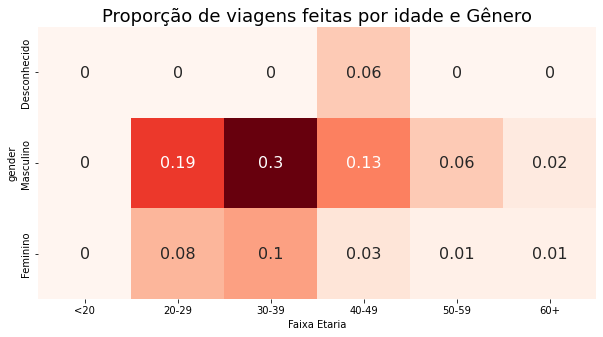

In [40]:
plt.figure(figsize = (10,5))
ax = sns.heatmap(gender_age, annot=True, linewidths=0, cbar=False, cmap="Reds", annot_kws={"size": 16})
ax.set_title('Proporção de viagens feitas por idade e Gênero', fontsize=18)
plt.show()


O nosso dataset possui `32%` de homens com faixa etária de `30 a 39 anos`. Enquanto temos `9%` para mulheres na mesma faixa etária.

#### Viagens durante a semana por gênero

In [41]:
fig = px.histogram(df, x="start_weekday_name",
             color='gender', barmode='group',
             height=400, labels={0: "Desconhcido", 1: "Masculino", 2: "Feminino"})
fig.update_xaxes(categoryorder='array', categoryarray= weekOrder)
fig.update_layout(legend_title_text='Gênero')
fig.show()

Os homems estão predominantemente todos os dia da semana, com um destaque na quarta-feira e quinta-feira junto das mulheres. Já o desconhecido aproveita mais os finais de semana.

## Qual o horário de maior demanda?

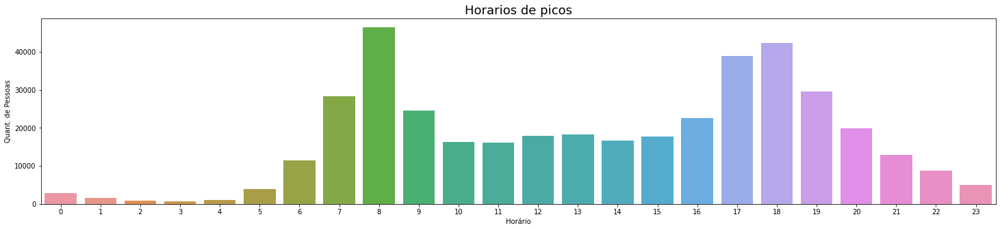

In [42]:
plt.figure(figsize = (25,5))
ax = sns.countplot(x=df["start_hours"])
ax.set(xlabel='Horário', ylabel='Quant. de Pessoas')
plt.title('Horarios de picos', fontsize=18)
plt.show()

Temos 2 pontos máximo em nosso gráfico, sendo o global as `8h`, ou seja, é o horário mais procurado para alugar uma bicicleta, e nosso máximo local as `18h`. Podemos partir da `hipótese` que o razão disso seja a ida e vinda do trabalho.

### Tipos diferentes de usuário influencia no horário?

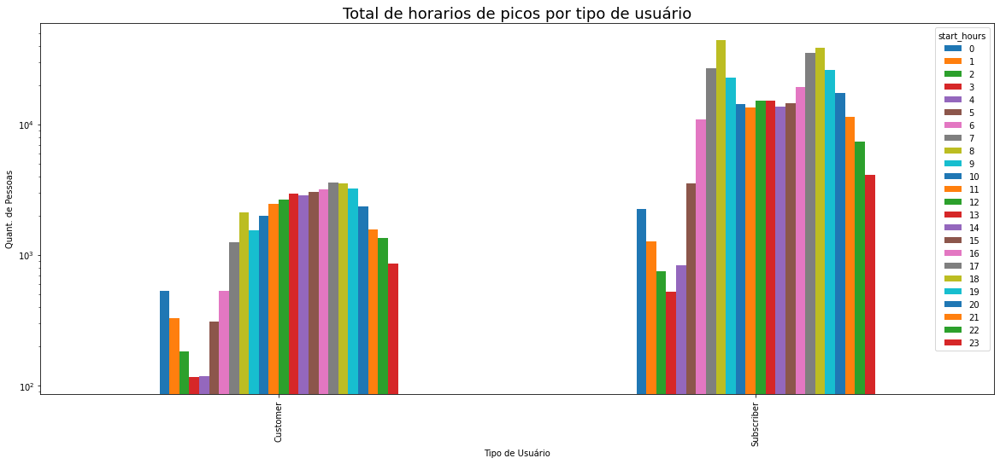

In [43]:
# Horario de picos por tipo de usuário
day=range(0,24)
count_usertype = df.groupby(['usertype','start_hours']).size().unstack()
ax = count_usertype.plot(kind = 'bar',figsize=(20,8))
ax.set(xlabel='Tipo de Usuário', ylabel='Quant. de Pessoas')
ax.get_figure().get_axes()[0].set_yscale('log')
plt.title('Total de horarios de picos por tipo de usuário', fontsize=18)
plt.show()

Temos diferença no pico para cada tipo de usuário, podemos ver que o pico das `8h` e `18h` esta mais relacionado aos clientes assinantes, enquanto os clientes "avulsos" possuem um certo padrão linear para buscar no peréodo da tarde. Fortalecendo nossa hipótese de que os assinantes usam mais para a ida e volta do trabalho. Vamos veriricar claramente isso dividindo em dia de semana e final de semana.

### Há diferença entre dia de semana e finais de semana?

In [44]:
# Separando dia util de final de semana
weekType = np.where(df['start_weekday'] < 5, 'Weekday', 'Weekend')

In [45]:
# Calculando a quantidades de horas para o dia da semana (Seg-Sex)
weekday = df[weekType == 'Weekday']
weekday = weekday['start_hours'].value_counts().sort_index()

# Calcuando para o final de semana
weekend = df[weekType != 'Weekday']
weekend = weekend['start_hours'].value_counts().sort_index()

# Calculo total
week_all = df['start_hours'].value_counts().sort_index()

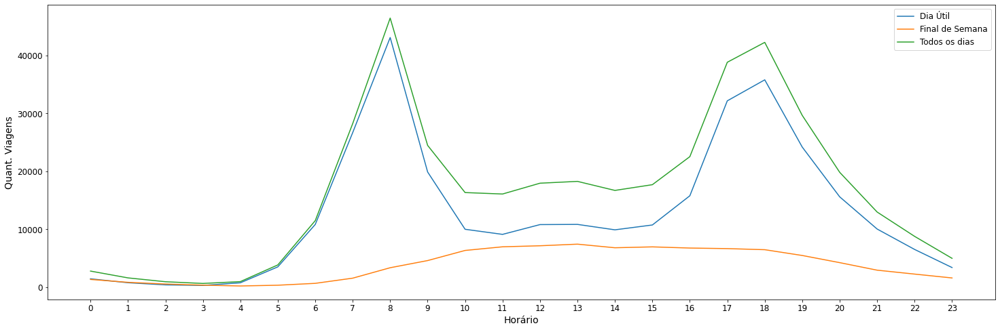

In [46]:
plt.figure(figsize = (25,8))
plt.plot(weekday)
plt.plot(weekend)
plt.plot(week_all)
plt.legend(['Dia Útil', 'Final de Semana', 'Todos os dias'], fontsize=12)
plt.xticks(range(0,24),weekday.index, fontsize=10)
plt.tick_params(axis='both', which='major', labelsize=12)

#labels
plt.xlabel('Horário', fontsize=14)
plt.ylabel('Quant. Viagens', fontsize=14)
plt.show()

Os picos das 8h e 18h se mantiveram durante os dia de semana. Enquanto finais de semana a procura é mais pelo turno da tarde, um horário mais voltado para o lazer. Reforçando o gráfico anterior, onde o gráfico do dia de semana é parecido com os ciclistas assinantens. Enquanto os não inscritos procuram alugam mais para o lazer.

## Qual dia da semana de maior procura?

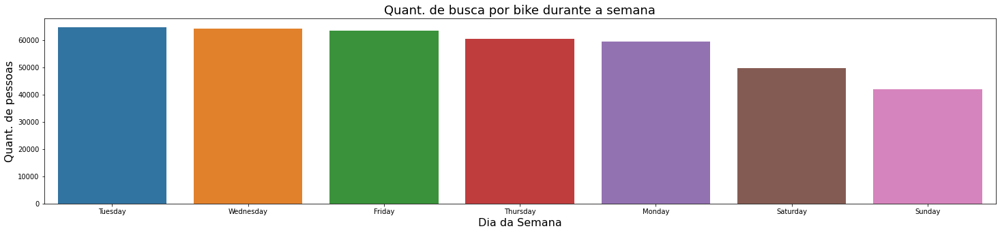

In [47]:
plt.figure(figsize = (25,5))
ax = sns.countplot(data= df, x = 'start_weekday_name', order = df['start_weekday_name'].value_counts().index)
plt.xlabel('Dia da Semana', fontsize=16)
plt.ylabel('Quant. de pessoas', fontsize=16)
plt.title('Quant. de busca por bike durante a semana', fontsize=18)
plt.show()

### O tempo de viagem tem alguma relação com a idade e o dia da semana?

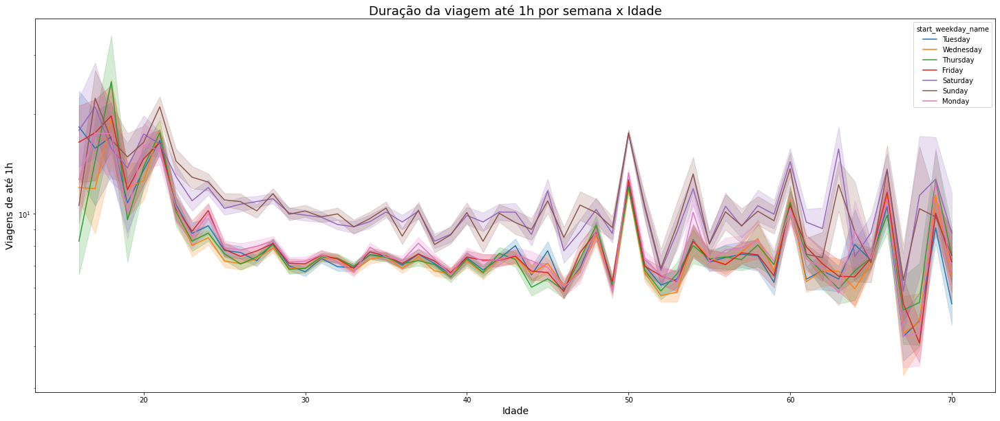

In [48]:
# Verificando duração da viagem por dia da semana em relação a idade
plt.figure(figsize = (25,10))
ax = sns.lineplot(y='tripduration_in_min', x='age', data=df[df['tripduration_in_min'] < 61], hue='start_weekday_name')
ax.get_figure().get_axes()[0].set_yscale('log')
plt.title('Duração da viagem até 1h por semana x Idade', fontsize=18)
plt.xlabel('Idade', fontsize=14)
plt.ylabel('Viagens de até 1h', fontsize=14)
plt.show()

Independente da idade, as clientes costumam ter viagens mais longas nos finais de semana, vamos confirmar isso no próximo grafico.

### Dia da semana com viagens mais longas

In [49]:
dfWeek = pd.DataFrame()
dfWeek['Week Name'] = df['start_weekday_name']
dfWeek['tripduration'] = df['tripduration']
dfWeek = dfWeek.groupby(['Week Name']).sum().reset_index()

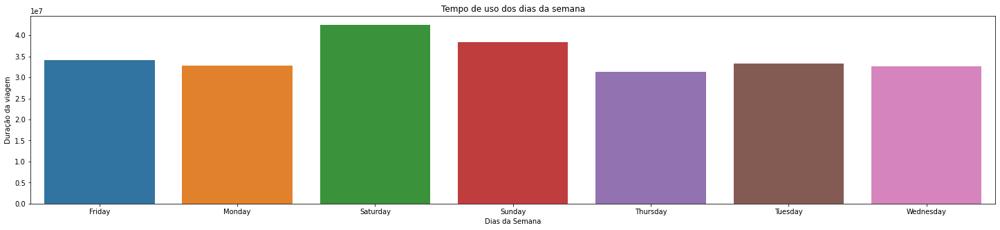

In [50]:
plt.figure(figsize = (25,5))
ax = sns.barplot(data =dfWeek ,x='Week Name',
       y='tripduration')
ax.set(xlabel='Dias da Semana', ylabel='Duração da viagem', title='Tempo de uso dos dias da semana')
plt.show()

## Estações mais procuradas

In [51]:
# Número de estações
print('Quantidade de estações: ',df['start station name'].nunique())

Quantidade de estações:  53


### Estações mais populares

In [52]:
stations = df.groupby(['start station latitude', 'start station longitude', 'start station name']).size().reset_index(name = 'Amount People')
stations = stations.sort_values('Amount People',ascending = False)

fig = px.scatter_mapbox(stations, lat="start station latitude", lon="start station longitude", hover_name = "start station name", color = "Amount People",
                  size = "Amount People", color_continuous_scale=px.colors.cyclical.IceFire,width=900, height=600, zoom=12.5, mapbox_style="carto-positron",
                    )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

### As 10 estações mais populares

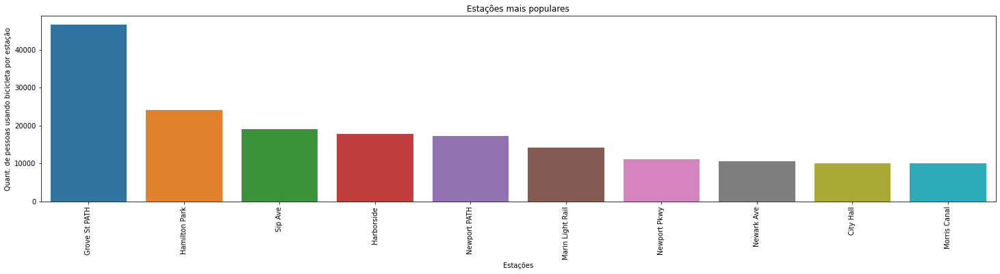

In [53]:
topStartStation = df["start station name"].value_counts().head(10)
plt.figure(figsize = (25,5))
ax = sns.barplot(x=topStartStation.index,
       y=topStartStation)
ax.set(xlabel='Estações', ylabel='Quant. de pessoas usando bicicleta por estação', title='Estações mais populares')
plt.xticks(rotation=90)
plt.show()

### Existe alguma relação das 10 estações mais pupolares com a idade?

In [54]:
df_age = pd.DataFrame(df[['start station name','ageGroup']].value_counts()).reset_index().rename(columns={'start station name': 'estacao', 'ageGroup': 'faixa etaria', 0:'quant'})
df_age.drop_duplicates(['estacao']).head(10)


,estacao,faixa etaria,quant
0,Grove St PATH,30-39,20168
3,Hamilton Park,30-39,9164
4,Sip Ave,30-39,7201
5,Marin Light Rail,30-39,6775
6,Harborside,30-39,6417
7,Newport PATH,30-39,6292
13,Brunswick & 6th,30-39,4938
14,Monmouth and 6th,30-39,4892
15,Warren St,30-39,4408
16,City Hall,30-39,4334


Incrivelmente a faixa estária de `30-39` anos está predominando.

### As 10 rotas mais populares

Vamos verificar quais são as rotas Origem-Destino mais realizadas.

In [55]:
trips = df.groupby(['start station name','end station name']).size().reset_index(name = 'Num. of Trips')
trips = trips.sort_values('Num. of Trips',ascending = False)
trips.head(10)

,start station name,end station name,Num. of Trips
991,Hamilton Park,Grove St PATH,8778
939,Grove St PATH,Hamilton Park,6048
224,Brunswick & 6th,Grove St PATH,5251
1764,Marin Light Rail,Grove St PATH,4450
1406,Jersey & 6th St,Grove St PATH,4370
955,Grove St PATH,Marin Light Rail,4167
276,Brunswick St,Grove St PATH,4078
1866,Monmouth and 6th,Grove St PATH,3993
632,Dixon Mills,Grove St PATH,3870
1845,McGinley Square,Sip Ave,3806


As rotas mais populares possuem uma relação de localização, sendo concentrada no centro da cidade de Jersey.

### Quantidades de vezes que uma estação foi escolida  como Destino e Origem por mês

#### Escolhida como Origem

In [56]:
# Número de vezes que cada estação serviu de origem para uma viagem em cada mês
startStation = df.groupby(['start station name', 'start_month']).size().reset_index().rename(columns={'start station name': 'estacao', 'start_month': 'mes', 0:'quant origem'})
startStation = startStation.sort_values('quant origem',ascending = False)
startStation.head(10)

,estacao,mes,quant origem
204,Grove St PATH,August,5458
214,Grove St PATH,September,5279
208,Grove St PATH,July,4833
213,Grove St PATH,October,4674
209,Grove St PATH,June,4492
211,Grove St PATH,May,4113
203,Grove St PATH,April,3725
212,Grove St PATH,November,3577
226,Hamilton Park,September,3123
210,Grove St PATH,March,3112


#### Escolhida como Destino

In [57]:
# Número de vezes que cada estação foi o destino de uma viagem de cada mês
endStation = df.groupby(['end station name', 'start_month']).size().reset_index().rename(columns={'end station name': 'estacao', 'start_month': 'mes', 0:'quant destino'})
endStation = endStation[endStation['estacao'].isin(df['start station name'].unique())].reset_index(drop = True)
endStation = endStation.sort_values('quant destino',ascending = False)
endStation.head(10)

,estacao,mes,quant destino
213,Grove St PATH,October,6766
204,Grove St PATH,August,6671
214,Grove St PATH,September,6541
208,Grove St PATH,July,6265
211,Grove St PATH,May,5283
209,Grove St PATH,June,5223
212,Grove St PATH,November,5048
203,Grove St PATH,April,4577
210,Grove St PATH,March,3486
205,Grove St PATH,December,3027


#### Resultado final das escolhas

In [58]:
# Resultado final
station_use = pd.merge(startStation, endStation, on=['estacao', 'mes'])
station_use['total'] = station_use['quant origem'] + station_use['quant destino']
station_use = station_use.sort_values('total',ascending = False)
station_use.head(10)

,estacao,mes,quant origem,quant destino,total
0,Grove St PATH,August,5458,6671,12129
1,Grove St PATH,September,5279,6541,11820
3,Grove St PATH,October,4674,6766,11440
2,Grove St PATH,July,4833,6265,11098
4,Grove St PATH,June,4492,5223,9715
5,Grove St PATH,May,4113,5283,9396
7,Grove St PATH,November,3577,5048,8625
6,Grove St PATH,April,3725,4577,8302
9,Grove St PATH,March,3112,3486,6598
8,Hamilton Park,September,3123,2840,5963


### Número total de vezes que cada estação foi usada por mês

In [59]:
pd.crosstab(index = station_use['estacao'], columns = station_use['mes'], values = station_use['total'], aggfunc = 'sum')

mes,April,August,December,February,January,July,June,March,May,November,October,September
estacao,,,,,,,,,,,,
5 Corners Library,505.0,538.0,162.0,200.0,176.0,524.0,455.0,330.0,429.0,292.0,509.0,588.0
Astor Place,654.0,782.0,521.0,452.0,485.0,696.0,810.0,528.0,702.0,603.0,689.0,723.0
Baldwin at Montgomery,694.0,891.0,341.0,394.0,416.0,873.0,835.0,429.0,740.0,535.0,730.0,807.0
Bergen Ave,541.0,605.0,416.0,328.0,271.0,636.0,627.0,336.0,577.0,557.0,719.0,649.0
Brunswick & 6th,1538.0,1902.0,1099.0,852.0,954.0,1973.0,1561.0,1154.0,1479.0,1586.0,1920.0,1999.0
Brunswick St,1307.0,1916.0,832.0,964.0,861.0,1729.0,1554.0,1123.0,1381.0,1138.0,1694.0,1759.0
Christ Hospital,373.0,382.0,201.0,168.0,240.0,420.0,463.0,266.0,407.0,306.0,428.0,449.0
City Hall,1808.0,2239.0,982.0,1022.0,1069.0,2210.0,2231.0,1440.0,1919.0,1413.0,1973.0,2493.0
Columbus Dr at Exchange Pl,NaN,4799.0,1653.0,NaN,NaN,2275.0,NaN,NaN,NaN,2802.0,4041.0,4841.0


### Classificação da duração da viagem

In [60]:
df['TripDurationMinGroup']=pd.cut(
   df['tripduration_in_min'],
   bins=[0, 6, 16, 31, 46, sys.maxsize],
   labels=['1-5', '15-29', '30-44', '45-59', '60+']
)

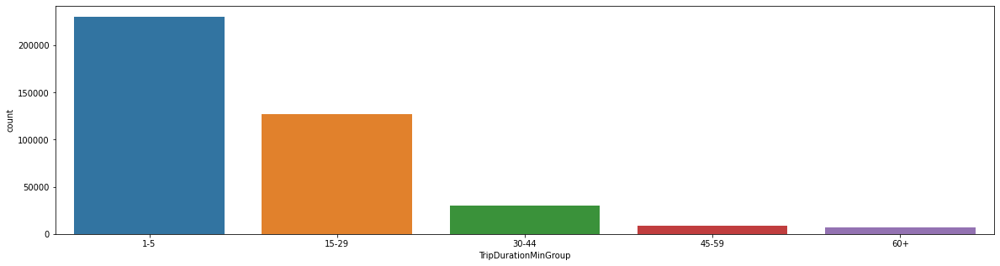

In [61]:
plt.figure(figsize = (20,5))
sns.countplot(x=df["TripDurationMinGroup"])
plt.show()

### Relação de viagem que começam e terminam na mesma estação

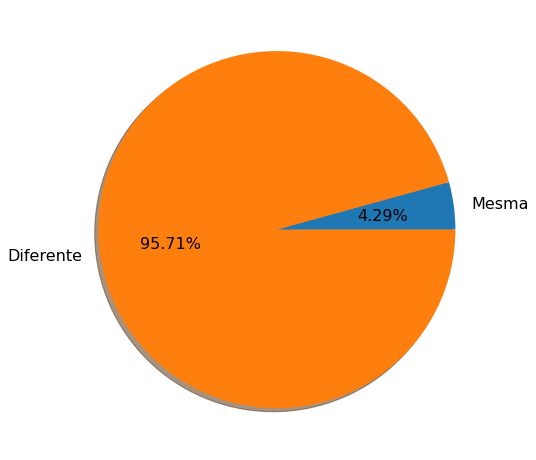

In [62]:
# Quantidade de viagem que começam e terminam na mesma estação
same = df[df['start station name'] == df['end station name']].shape[0]

#Quantidade de viagens que começaram e terminanram em estações diferentes
diff = df.shape[0]-same

plt.figure(figsize=(8,10))
plt.pie([same,diff], labels=['Mesma', 'Diferente'],
        shadow=True,  autopct='%1.2f%%', textprops={'fontsize': 16})
# ax1.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.show()

### Distribuição da idade e gênero por estação

#### Ditribuição gênero por estação

In [63]:
stationGender = df.groupby(['start station name', 'gender']).size().reset_index(name='count')
stationGender = stationGender[stationGender['start station name'].isin(topStartStation.index)].reset_index(drop = True)
stationGender['gender'] = stationGender['gender'].map({0:'desconhecido', 1: 'masculino', 2: 'feminino'})

In [64]:
fig = px.bar(stationGender, x='start station name', y='count',
             color='gender', log_y=True,
              height=400)
fig.show()

#### Ditribuição idade por estação

In [65]:
stationAge = df.groupby(['start station name', 'gender', 'ageGroup']).size().reset_index(name='count')
stationAge = stationAge[stationAge['start station name'].isin(topStartStation.index)].reset_index(drop = True)

In [66]:
fig = px.histogram(stationAge, x="start station name", y='count',
             color='ageGroup', barmode='group',
             height=400, title='Idade x Estação', log_y=True)
fig.update_xaxes(categoryorder='array', categoryarray= weekOrder)

fig.show()

Por se tratar de uma área residencial, a Sip Ave concentrar grande partes dos jovens menores de 20 anos. Para as demais idades, temos uma distribuição parecida.

## Analisando Corridas Paralelas

Iremos levar em consideração um difereça de `30 segundos` entre as saídas.

In [67]:
df_paralela = df[['starttime', 'stoptime', 'start station name', 'end station name']].copy()
df_paralela["starttime"] = df_paralela["starttime"].dt.round("min")
df_paralela["stoptime"] = df_paralela["stoptime"].dt.round("min")

In [68]:
df_paralela['User Row'] = df_paralela.index.astype(str)
df_paralela.head()

,starttime,stoptime,start station name,end station name,User Row
0,2019-01-01 03:09:00,2019-01-01 03:13:00,Exchange Place,Essex Light Rail,0
1,2019-01-01 05:18:00,2019-01-01 05:26:00,Exchange Place,Washington St,1
2,2019-01-01 10:37:00,2019-01-01 10:49:00,Exchange Place,Liberty Light Rail,2
3,2019-01-01 12:44:00,2019-01-01 13:10:00,Exchange Place,Washington St,3
4,2019-01-01 12:44:00,2019-01-01 13:10:00,Exchange Place,Washington St,4


In [69]:
df_2 = df_paralela.groupby(['starttime','stoptime','start station name','end station name'], as_index = False).agg({'User Row': ','.join}).reset_index(drop=True)
df_duplas = df_2[df_2['User Row'].str.contains(",")].reset_index(drop=True)
df_duplas

,starttime,stoptime,start station name,end station name,User Row
0,2019-01-01 01:03:00,2019-01-01 01:07:00,Manila & 1st,Hamilton Park,"14389,14390"
1,2019-01-01 09:45:00,2019-01-01 09:48:00,Jersey & 6th St,Newark Ave,"13410,13411"
2,2019-01-01 11:34:00,2019-01-01 11:37:00,Hamilton Park,Manila & 1st,"8143,8144,8145"
3,2019-01-01 12:44:00,2019-01-01 13:10:00,Exchange Place,Washington St,"3,4"
4,2019-01-01 13:48:00,2019-01-01 14:05:00,Grove St PATH,Grand St,"1699,1700"
...,...,...,...,...,...
10507,2019-12-31 18:46:00,2019-12-31 18:48:00,Columbus Dr at Exchange Pl,Harborside,"404864,404865"
10508,2019-12-31 19:07:00,2019-12-31 19:14:00,Liberty Light Rail,Grove St PATH,"404870,404872"
10509,2019-12-31 19:07:00,2019-12-31 19:15:00,City Hall,Brunswick St,"404871,404873"
10510,2019-12-31 19:18:00,2019-12-31 19:23:00,Harborside,Newport PATH,"404879,404880"


In [70]:
# Testando se os ciclistas sairam juntos
df.loc[3:4][['starttime', 'stoptime', 'start station name', 'end station name']]

,starttime,stoptime,start station name,end station name
3,2019-01-01 12:43:38.643,2019-01-01 13:09:54.528,Exchange Place,Washington St
4,2019-01-01 12:43:39.601,2019-01-01 13:09:46.510,Exchange Place,Washington St


In [71]:
# Verificando o maior grupo de pessoas pedalando juntas
df_duplas['User Row'].str.split(',').agg(len).to_frame(name='Count').max()


Count    6
dtype: int64

### As 10 estações de origem mais escolhidas para sair em grupo

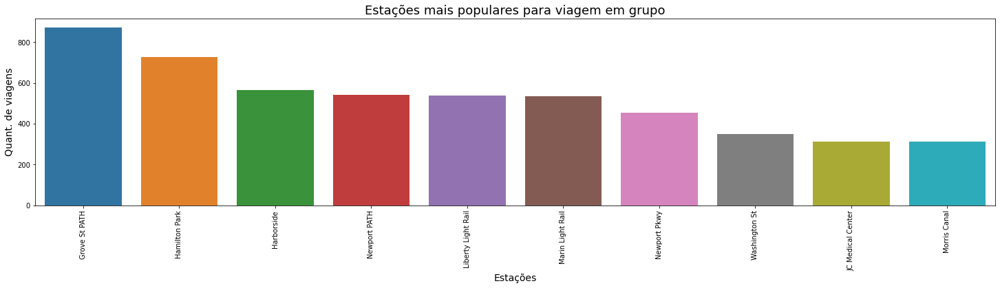

In [72]:
popularStation = df_duplas.groupby(['start station name']).size().sort_values(ascending=False).head(10)
plt.figure(figsize = (25,5))
ax = sns.barplot(x=popularStation.index, y=popularStation)
plt.xticks(rotation=90)
plt.title('Estações mais populares para viagem em grupo', fontsize=18)
plt.xlabel('Estações', fontsize=14)
plt.ylabel('Quant. de viagens', fontsize=14)
plt.show()

### As 10 rotas mais escolhidas para sair em grupo

In [73]:
trips = df_duplas.groupby(['start station name','end station name']).size().reset_index(name = 'Num. of Trips')
trips = trips.sort_values('Num. of Trips',ascending = False)
trips.head(10)

,start station name,end station name,Num. of Trips
499,Hamilton Park,Grove St PATH,273
826,Liberty Light Rail,Liberty Light Rail,208
94,Brunswick & 6th,Grove St PATH,168
124,Brunswick St,Grove St PATH,121
972,Monmouth and 6th,Grove St PATH,116
912,Marin Light Rail,Grove St PATH,115
460,Grove St PATH,Hamilton Park,112
473,Grove St PATH,Marin Light Rail,103
720,Jersey & 6th St,Grove St PATH,99
1103,Newport PATH,Harborside,99


## Conclusão

- Podemos ver um maior número de ciclistas do sexo masculino. 
- Podemos ver que há mais assinantes anuais do que clientes comuns. 
- Os horários mais procurados são as 8h e 18h, consequentimente horarios de inicio e termino de espediente.
- Há um grande numero de pessoa na faixa etária de 30 a 39 anos.
- Há um baixo numero de clientes mês de Maio.
- Quase 96% dos passeios têm diferentes locais de início e término.
- O maior numero de pessoas andando juntas foram de 6.
- As estações do centro da cidade são as mais procuradas.
- Os não assinantes usam mais durante o final de semana.
- Grande parte do jovens menos de 20 anos, usam no bairro vizinho ao centro da cidade.

# Predição

In [74]:
from statsmodels.tsa.seasonal import seasonal_decompose

In [76]:
def applyer(row):
    if row.dayofweek == 5 or row.dayofweek == 6:
        return 1
    else:
        return 0

In [98]:
df_serie = pd.DataFrame()
df_serie['starttime'] = df['starttime'].dt.round('h')
df_serie

,starttime
0,2019-01-01 03:00:00
1,2019-01-01 05:00:00
2,2019-01-01 11:00:00
3,2019-01-01 13:00:00
4,2019-01-01 13:00:00
...,...
404942,2019-12-31 23:00:00
404943,2019-12-31 23:00:00
404944,2019-12-31 23:00:00
404945,2019-12-31 23:00:00


In [99]:
df_serie = df_serie.groupby(['starttime']).size().reset_index(name='count_trip')
data2 = df_serie

In [100]:
df_serie['hour'] = df_serie['starttime'].dt.hour
df_serie['day'] = df_serie['starttime'].dt.day
df_serie['day_of_week'] = df_serie['starttime'].dt.weekday
df_serie['weekend'] = df_serie['starttime'].apply(applyer)

In [101]:
df_serie

,starttime,count_trip,hour,day,day_of_week,weekend
0,2019-01-01 00:00:00,2,0,1,1,0
1,2019-01-01 01:00:00,3,1,1,1,0
2,2019-01-01 02:00:00,5,2,1,1,0
3,2019-01-01 03:00:00,6,3,1,1,0
4,2019-01-01 04:00:00,5,4,1,1,0
...,...,...,...,...,...,...
8430,2019-12-31 20:00:00,25,20,31,1,0
8431,2019-12-31 21:00:00,14,21,31,1,0
8432,2019-12-31 22:00:00,10,22,31,1,0
8433,2019-12-31 23:00:00,10,23,31,1,0


In [102]:
data = df_serie
data.set_index('starttime', inplace=True)
# data.index = pd.DatetimeIndex(data.index).to_period('h')

In [103]:
fig = px.line(data,y='count_trip')
fig.show()

In [107]:
decomposicao = seasonal_decompose(data.count_trip, period=24, model='additive')

In [108]:
tendencia = decomposicao.trend
sazonal = decomposicao.seasonal
aleatorio = decomposicao.resid

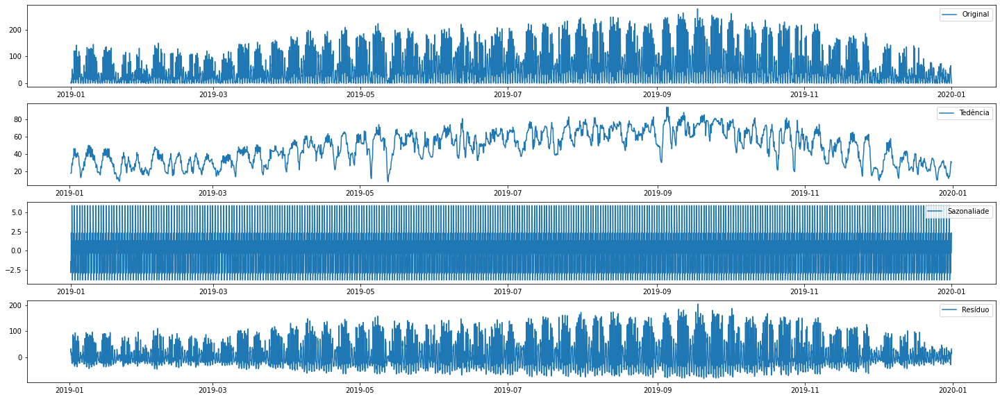

In [109]:
fig, ax = plt.subplots(4, 1, figsize=(25,10))
# create subplots
ax[0].plot(data.count_trip, label= 'Original')
ax[0].legend()

ax[1].plot(tendencia, label= 'Tedência')
ax[1].legend()

ax[2].plot(sazonal, label= 'Sazonaliade')
ax[2].legend()

ax[3].plot(aleatorio, label= 'Resíduo')
ax[3].legend()



In [110]:
hourly = data.resample('H').mean() 
daily = data.resample('D').mean() 
weekly = data.resample('W').mean() 
monthly = data.resample('M').mean()

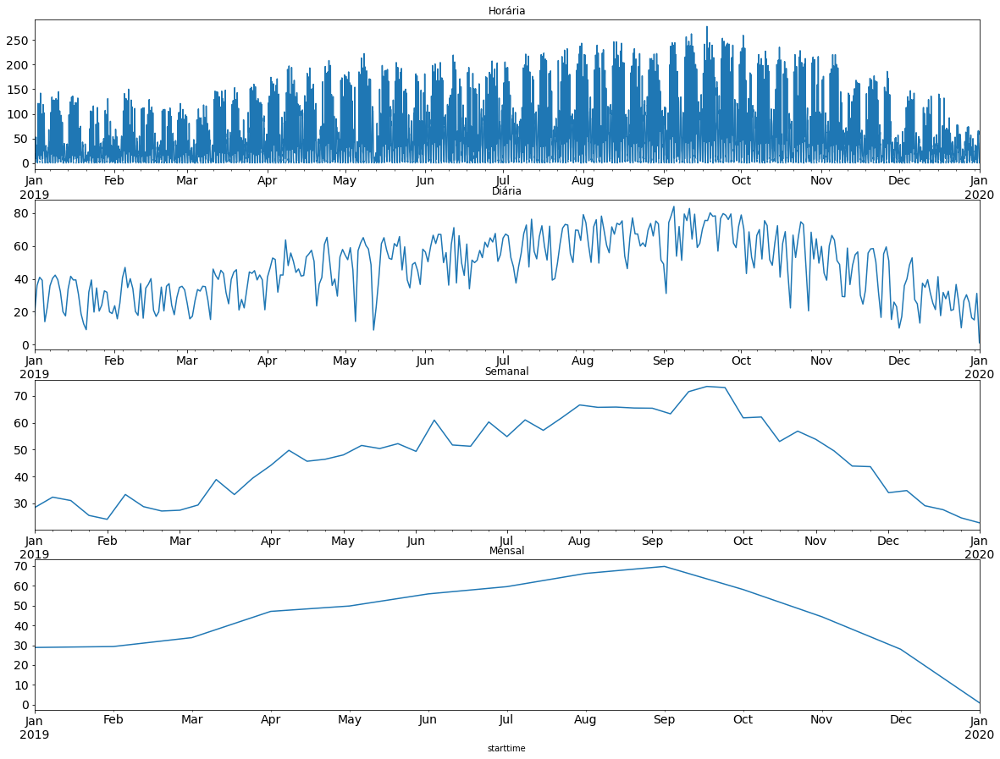

In [111]:
fig, axs = plt.subplots(4,1) 
hourly.count_trip.plot(figsize=(20,15), title= 'Horária', fontsize=14, ax=axs[0])
daily.count_trip.plot(figsize=(20,15), title= 'Diária', fontsize=14, ax=axs[1])
weekly.count_trip.plot(figsize=(20,15), title= 'Semanal', fontsize=14, ax=axs[2]) 
monthly.count_trip.plot(figsize=(20,15), title= 'Mensal', fontsize=14, ax=axs[3]) 
plt.show()

In [131]:
treino = data.loc['2019-01-01':'2019-09-01']
teste = data.loc['2019-09-01':]

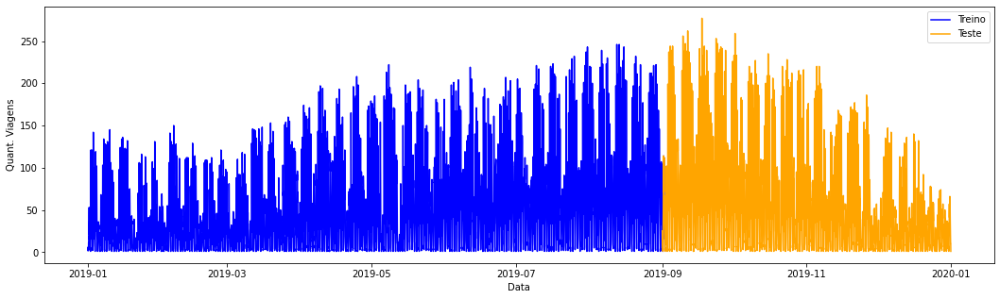

In [113]:
plt.figure(figsize=(18,5))
plt.plot(treino['count_trip'], color='b')
plt.plot(teste['count_trip'], color='orange')
plt.legend(['Treino','Teste'])
plt.xlabel('Data')
plt.ylabel('Quant. Viagens')
plt.show()

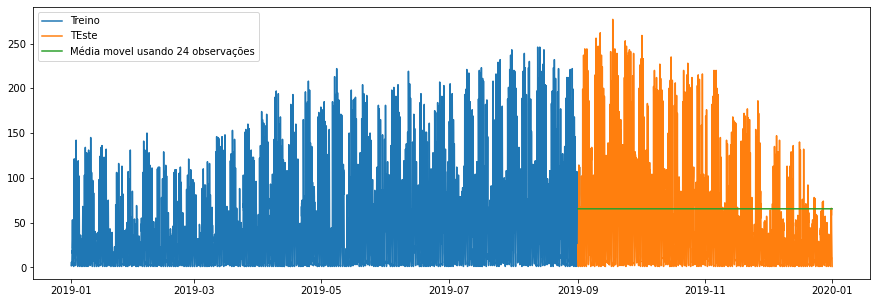

In [114]:
y_hat_avg = teste.copy() 
y_hat_avg['moving_avg_forecast'] = treino['count_trip'].rolling(720).mean().iloc[-1] 
plt.figure(figsize=(15,5)) 
plt.plot(treino['count_trip'], label='Treino') 
plt.plot(teste['count_trip'], label='TEste') 
plt.plot(y_hat_avg['moving_avg_forecast'], 
                label='Média movel usando 24 observações')

plt.legend(loc='best') 
plt.show()


In [115]:
from sklearn.metrics import mean_squared_error 
from math import sqrt 
rms = sqrt(mean_squared_error(teste.count_trip, y_hat_avg.moving_avg_forecast))
print(rms)

53.13039353688958


In [160]:
import numpy as np
 
months = [x.month for x in treino.index]
years = [x.year for x in treino.index]
day = [x.day for x in treino.index]
hour = [x.hour for x in treino.index]
X = np.array([day, months, years,hour]).T


months = [x.month for x in teste.index]
years = [x.year for x in teste.index]
day = [x.day for x in teste.index]
hour = [x.hour for x in teste.index]

teste1 = np.array([day, months, years,hour]).T

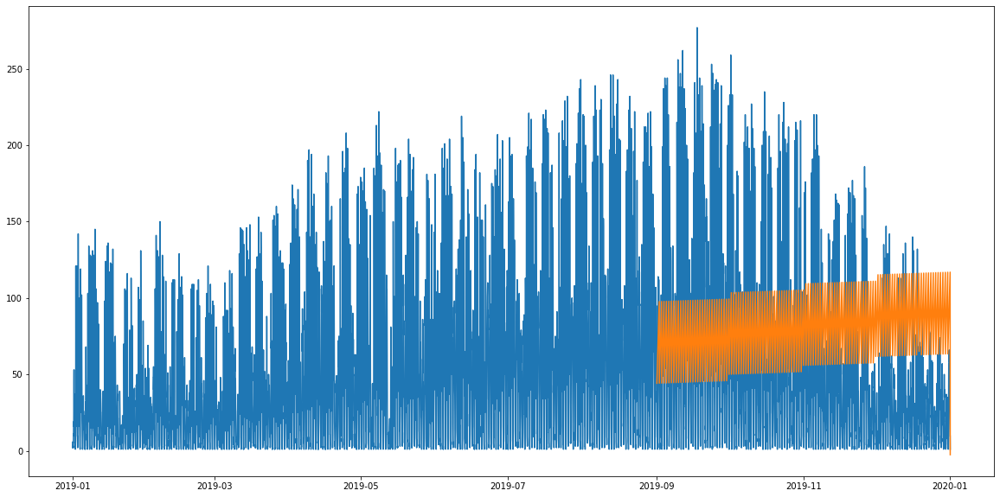

In [161]:
from sklearn.linear_model import LinearRegression
 
reg = LinearRegression()
reg.fit(X, treino.count_trip.values)
 
preds = reg.predict(teste1)
plt.figure(figsize=(20,10)) 
 
plt.plot(data.index, data.count_trip.values)
plt.plot(teste.index, preds)

<Figure size 1440x720 with 0 Axes>

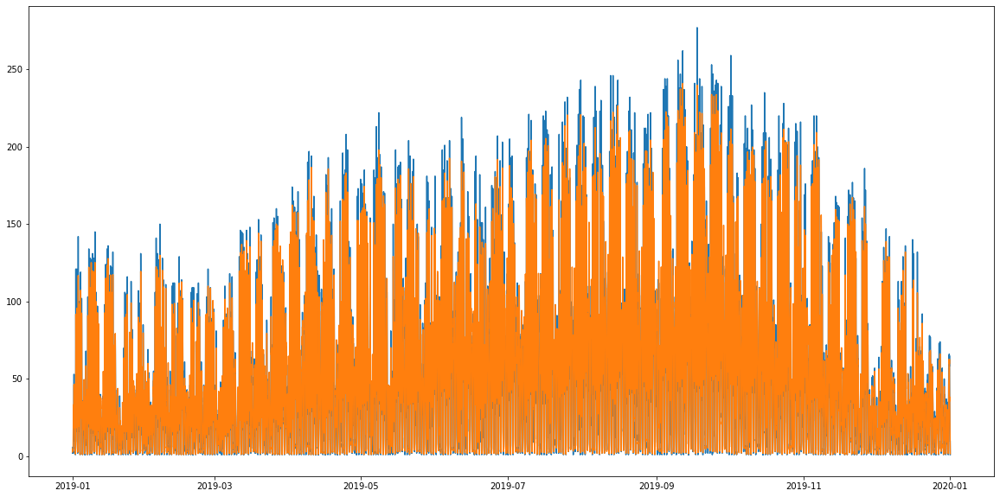

In [151]:
from sklearn.ensemble import RandomForestRegressor
 
# fit the model
my_rf = RandomForestRegressor()
my_rf.fit(X, data.count_trip.values)
 
# predict on the same period
preds = my_rf.predict(X)
 
plt.figure(figsize=(20,10)) 

# plot what has been learned
plt.plot(data.index, data.count_trip.values)
plt.plot(data.index, preds)

In [138]:
# Import the library
from pmdarima import auto_arima
  
# Ignore harmless warnings
import warnings
warnings.filterwarnings("ignore")
  
stepwise_fit = auto_arima(data['count_trip'], start_p = 1, start_q = 1,
                          max_p = 3, max_q = 3, m = 24,
                          start_P = 0, seasonal = True,
                          d = None, D = 1, trace = True,
                          error_action ='ignore',   # we don't want to know if an order does not work
                          suppress_warnings = True,  # we don't want convergence warnings
                          stepwise = True)           # set to stepwise
  
# To print the summary
stepwise_fit.summary()

Performing stepwise search to minimize aic
 ARIMA(1,0,1)(0,1,1)[24] intercept   : AIC=79554.259, Time=91.41 sec
 ARIMA(0,0,0)(0,1,0)[24] intercept   : AIC=86727.712, Time=3.37 sec
 ARIMA(1,0,0)(1,1,0)[24] intercept   : AIC=82192.405, Time=88.20 sec
 ARIMA(0,0,1)(0,1,1)[24] intercept   : AIC=80705.726, Time=73.08 sec
 ARIMA(0,0,0)(0,1,0)[24]             : AIC=86725.718, Time=3.28 sec
 ARIMA(1,0,1)(0,1,0)[24] intercept   : AIC=81693.091, Time=15.50 sec
 ARIMA(1,0,1)(1,1,1)[24] intercept   : AIC=inf, Time=104.98 sec


KeyboardInterrupt: 

In [ ]:
 # Fit a SARIMAX(0, 1, 1)x(2, 1, 1, 12) on the training set
from statsmodels.tsa.statespace.sarimax import SARIMAX
  
model = SARIMAX(treino['count_trip'], 
                order = (0, 1, 1), 
                seasonal_order =(2, 1, 1, 12))
  
result = model.fit()
result.summary()

In [ ]:
start = len(treino)
end = len(treino) + len(teste) - 1
  
# Predictions for one-year against the test set
predictions = result.predict(start, end,
                             typ = 'levels').rename("Predictions")
  
# plot predictions and actual values
predictions.plot(legend = True)
test['count_trip'].plot(legend = True)

In [105]:
from statsmodels.tsa.statespace.sarimax import SARIMAX

In [132]:
y = treino['count_trip']
# y.index = pd.DatetimeIndex(y.index).to_period('h')


In [125]:
ARMAmodel = SARIMAX(y, order = (1, 0, 1))

In [126]:
ARMAmodel = ARMAmodel.fit()

In [127]:
y_pred = ARMAmodel.get_forecast(len(teste.index))
y_pred_df = y_pred.conf_int(alpha = 0.05) 
y_pred_df["Predictions"] = ARMAmodel.predict(start = y_pred_df.index[0], end = y_pred_df.index[-1])
y_pred_df.index = teste.index
y_pred_out = y_pred_df["Predictions"] 

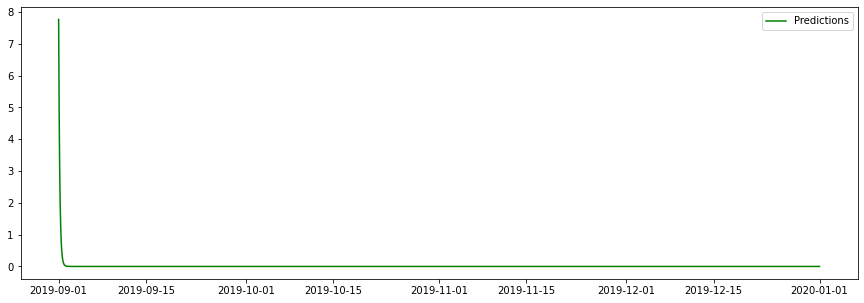

In [128]:
plt.figure(figsize=(15,5)) 
plt.plot(y_pred_out, color='green', label = 'Predictions')
plt.legend()

In [129]:
from statsmodels.tsa.arima.model import ARIMA

c:\Users\Marcos Eduardo\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\statespace\sarimax.py:978: UserWarning:

Non-invertible starting MA parameters found. Using zeros as starting parameters.

c:\Users\Marcos Eduardo\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



RMSE:  157602997.03563327


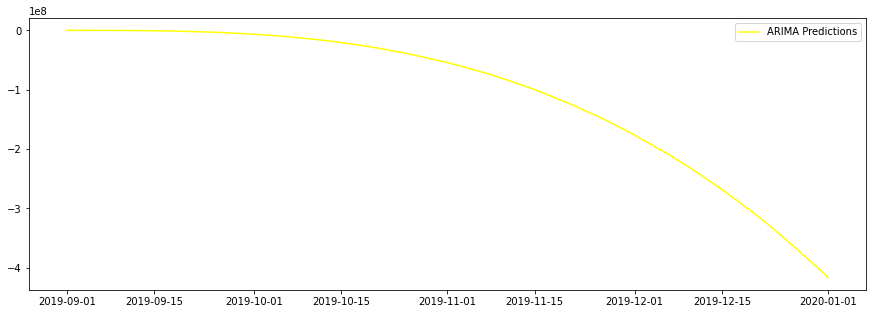

In [130]:
ARIMAmodel = ARIMA(y, order = (5,4,2))
ARIMAmodel = ARIMAmodel.fit()

y_pred = ARIMAmodel.get_forecast(len(teste.index))
y_pred_df = y_pred.conf_int(alpha = 0.05) 
y_pred_df["Predictions"] = ARIMAmodel.predict(start = y_pred_df.index[0], end = y_pred_df.index[-1])
y_pred_df.index = teste.index
y_pred_out = y_pred_df["Predictions"] 
plt.figure(figsize=(15,5)) 
plt.plot(y_pred_out, color='Yellow', label = 'ARIMA Predictions')
plt.legend()


import numpy as np
from sklearn.metrics import mean_squared_error

arma_rmse = np.sqrt(mean_squared_error(teste["count_trip"].values, y_pred_df["Predictions"]))
print("RMSE: ",arma_rmse)

# OUtra coisa

In [ ]:
df1 = pd.DataFrame(df['starttime'].dt.round('h'))
df1 = df1.groupby('starttime').size().reset_index(name='count_trip')

In [ ]:
df_day = (df1.groupby([df1['starttime'].dt.date, df1['starttime'].dt.hour])['count_trip']
            .sum()
            .unstack(fill_value=0))
df_day

starttime,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
starttime,,,,,,,,,,,,,,,,,,,,,
2019-01-01,2,3,5,6,5,2,3,2,11,10,...,53,32,21,31,37,26,23,17,13,5
2019-01-02,6,3,5,0,1,6,19,37,121,74,...,32,21,16,58,121,81,54,23,10,10
2019-01-03,0,4,2,0,0,8,29,45,142,101,...,26,16,29,61,99,100,62,22,16,11
2019-01-04,3,3,2,1,0,10,24,51,119,103,...,25,26,28,69,102,80,47,37,20,16
2019-01-05,5,2,2,1,0,0,2,7,15,16,...,14,18,15,14,15,22,16,23,12,9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-12-28,14,5,10,4,0,0,2,8,15,19,...,40,55,57,34,28,33,17,28,20,12
2019-12-29,11,6,8,0,0,1,2,4,10,22,...,40,23,25,19,12,7,6,4,10,2
2019-12-30,4,4,0,1,0,2,2,11,27,37,...,14,9,8,11,35,32,24,25,11,8


In [ ]:
from pmdarima.arima import auto_arima

In [ ]:
stepwise_model = auto_arima(data, start_p=1,start_q=1, start_d=0, start_P=0, max_p= 6, max_q=6, m=24, seasonal=True, trace=True, stepwise=True)

ValueError: y should be a 1d array, got an array of shape (8435, 6) instead.

In [ ]:
train = data.loc['2019-01-01':'2019-08-01']
test = data.loc['2019-09-01':]

In [ ]:
stepwise_model.fit(train)

ARIMA(order=(0, 1, 2), scoring_args={}, suppress_warnings=True,
      with_intercept=False)

In [ ]:
future_forecast = stepwise_model.predict(n_periods=24)

NameError: name 'stepwise_model' is not defined

In [ ]:
future_forecast

4895    30.101233
4896    37.525569
4897    37.525569
4898    37.525569
4899    37.525569
          ...    
7650    37.525569
7651    37.525569
7652    37.525569
7653    37.525569
7654    37.525569
Length: 2760, dtype: float64

In [ ]:
future_forecast = pd.DataFrame(future_forecast,index=test.index, columns=['count_trip'])

<AxesSubplot:xlabel='starttime'>

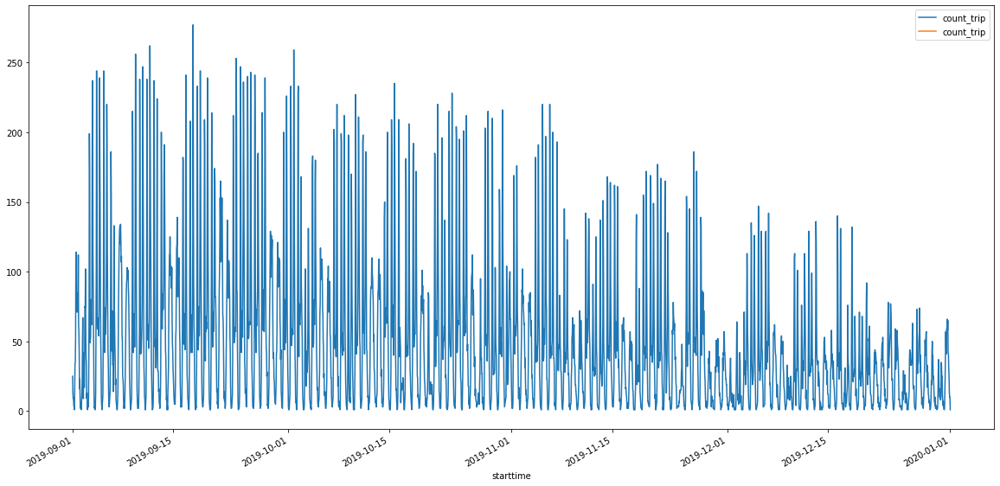

In [ ]:
pd.concat([test,future_forecast], axis=1).plot(figsize=(20,10))

In [ ]:
data2 = data.copy()

In [ ]:
from statsmodels.tsa.stattools import adfuller, kpss

In [ ]:
#Teste de Dickey Fuller
adfinput = adfuller(data2['count_trip'])
adftest = pd.Series(adfinput[0:4], index=['Teste Estatistico Dickey Fuller','Valor-P',
                                          'Lags Usados','Número de observações usadas'])
adftest = round(adftest,4)
    
for key, value in adfinput[4].items():
    adftest["Valores Críticos (%s)"%key] = value.round(4) 
adftest

Teste Estatistico Dickey Fuller      -8.1430
Valor-P                               0.0000
Lags Usados                          34.0000
Número de observações usadas       8400.0000
Valores Críticos (1%)                -3.4311
Valores Críticos (5%)                -2.8619
Valores Críticos (10%)               -2.5670
dtype: float64

# outro teste

In [ ]:
import pandas as pd 
import numpy as np          # For mathematical calculations 
import matplotlib.pyplot as plt  # For plotting graphs 
from datetime import datetime    # To access datetime 
from pandas import Series        # To work on series 
%matplotlib inline 
import warnings                   # To ignore the warnings
warnings.filterwarnings("ignore")

In [ ]:
train=pd.read_csv("train.csv") 
test=pd.read_csv("teste.csv")
print(train.head())
print(test.head())

   ID          Datetime  Count
0   0  25-08-2012 00:00      8
1   1  25-08-2012 01:00      2
2   2  25-08-2012 02:00      6
3   3  25-08-2012 03:00      2
4   4  25-08-2012 04:00      2
      ID          Datetime
0  18288  26-09-2014 00:00
1  18289  26-09-2014 01:00
2  18290  26-09-2014 02:00
3  18291  26-09-2014 03:00
4  18292  26-09-2014 04:00


Vamos fazer uma cópia dos dados de treinamento e teste para que, mesmo que façamos alterações nesses conjuntos de dados, não percamos o conjunto de dados original.

In [ ]:
train_original=train.copy()
test_original=test.copy()

In [ ]:
train.columns, test.columns

(Index(['ID', 'Datetime', 'Count'], dtype='object'),
 Index(['ID', 'Datetime'], dtype='object'))

Temos ID, Datetime e a contagem correspondente de passageiros no arquivo de treinamento. Para o arquivo de teste, temos apenas ID e Datetime, portanto, precisamos prever a contagem para o arquivo de teste.

Vamos entender cada recurso primeiro:

- ID é o número único dado a cada ponto de observação.
- Datetime é a hora de cada observação.
- A contagem é a contagem de passageiros correspondente a cada Datetime.

Vejamos os tipos de dados de cada recurso.

In [ ]:
train.dtypes, test.dtypes

(ID           int64
 Datetime    object
 Count        int64
 dtype: object,
 ID           int64
 Datetime    object
 dtype: object)

- ID e Count estão em formato inteiro enquanto Datetime está em formato de objeto para o arquivo de treinamento.
- ID está em inteiro e Datetime está em formato de objeto para o arquivo de teste.

Agora veremos a forma do conjunto de dados.

In [ ]:
train.shape, test.shape

((18288, 3), (5112, 2))

Temos 18.288 registros diferentes para a contagem de passageiros no conjunto de treino e 5.112 no conjunto de teste.

Agora vamos extrair mais recursos para validar nossa hipótese.

### Extração de recursos

Vamos extrair a hora e a data do Datetime. Vimos anteriormente que o tipo de dados de Datetime é um objeto. Então, antes de tudo, temos que alterar o tipo de dados para o formato DateTime, caso contrário, não podemos extrair recursos dele.

In [ ]:
train['Datetime'] = pd.to_datetime(train.Datetime,format='%d-%m-%Y %H:%M') 
test['Datetime'] = pd.to_datetime(test.Datetime,format='%d-%m-%Y %H:%M') 
test_original['Datetime'] = pd.to_datetime(test_original.Datetime,format='%d-%m-%Y %H:%M') 
train_original['Datetime'] = pd.to_datetime(train_original.Datetime,format='%d-%m-%Y %H:%M')

Fizemos algumas hipóteses para o efeito da hora, dia, mês e ano na contagem de passageiros. Então, vamos extrair o ano, mês, dia e hora do Datetime para validar nossa hipótese.

In [ ]:
for i in (train, test, test_original, train_original):
    i['year']=i.Datetime.dt.year 
    i['month']=i.Datetime.dt.month 
    i['day']=i.Datetime.dt.day    
    i['Hour']=i.Datetime.dt.hour

Fizemos uma hipótese para o padrão de tráfego em dias de semana e finais de semana também. Então, vamos criar uma variável de fim de semana para visualizar o impacto dos fins de semana no tráfego.

- Vamos primeiro extrair o dia da semana de Datetime e depois com base nos valores que atribuiremos se o dia é um fim de semana ou não.
- Valores de 5 e 6 representam que os dias são finais de semana.
- train['day of week']=train['Datetime'].dt.dayofweek
- temp = treinar['Datahora']

Vamos atribuir 1 se o dia da semana for um fim de semana e 0 se o dia da semana não for um fim de semana.

In [ ]:
train['day of week']=train['Datetime'].dt.dayofweek
temp = train['Datetime']

In [ ]:
def applyer(row):
    if row.dayofweek == 5 or row.dayofweek == 6:
        return 1
    else:
        return 0

In [ ]:
temp2 = train['Datetime'].apply(applyer) 
train['weekend']=temp2

Vejamos a série temporal.

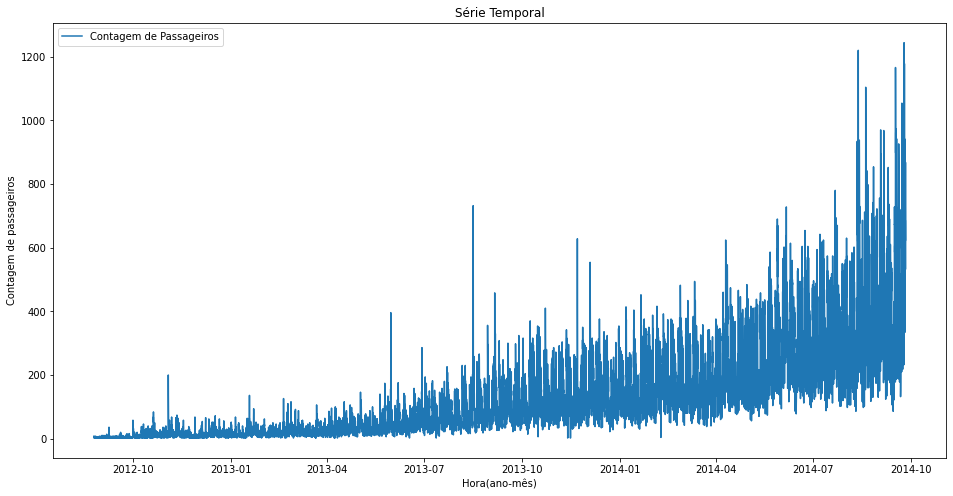

In [ ]:
train.index = train['Datetime']
df=train.drop('ID',1)
ts = df['Count']
plt.figure(figsize=(16,8))
plt.plot(ts, label='Contagem de Passageiros')
plt.title('Série Temporal')
plt.xlabel("Hora(ano-mês)")
plt.ylabel("Contagem de passageiros")
plt.legend(loc='best')

In [ ]:
fig = px.line(df,y='Count')
fig.show()

Aqui podemos inferir que há uma tendência crescente na série, ou seja, o número de contagens é crescente em relação ao tempo. Também podemos ver que em certos pontos há um aumento repentino no número de contagens. A possível razão por trás disso pode ser que em um determinado dia, devido a algum evento, o tráfego estava alto.

Trabalharemos no arquivo de treinamento para todas as análises e usaremos o arquivo de teste para previsão.

Vamos relembrar a hipótese que fizemos anteriormente:

- O tráfego aumentará com o passar dos anos
- Tráfego será alto de maio a outubro
- O tráfego durante a semana será mais
- Tráfego durante o horário de pico será alto


Depois de analisar o conjunto de dados, agora tentaremos validar nossa hipótese e fazer outras inferências a partir do conjunto de dados.

### Analise Exploratoria

Vamos tentar verificar nossa hipótese usando os dados reais.

Nossa primeira hipótese era que o tráfego aumentaria com o passar dos anos. Então, vamos olhar para a contagem anual de passageiros.

<AxesSubplot:xlabel='year'>

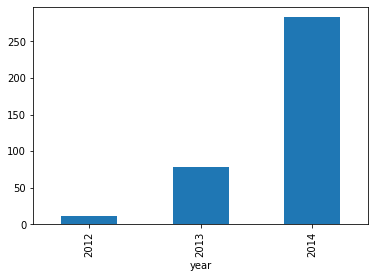

In [ ]:
train.groupby('year')['Count'].mean().plot.bar()

Vemos um crescimento exponencial do tráfego em relação ao ano o que valida nossa hipótese.

Nossa segunda hipótese foi sobre o aumento do tráfego de maio a outubro. Então, vamos ver a relação entre contagem e mês.

<AxesSubplot:xlabel='month'>

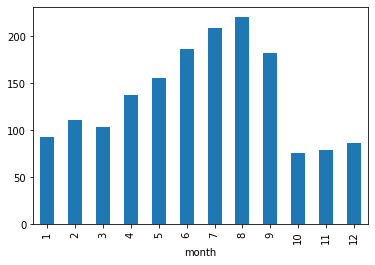

In [ ]:
train.groupby('month')['Count'].mean().plot.bar()

Aqui vemos uma diminuição na contagem média de passageiros nos últimos três meses. Isso não parece certo. Vejamos a média mensal de cada ano separadamente.

<AxesSubplot:title={'center':'Passenger Count(Monthwise)'}, xlabel='year,month'>

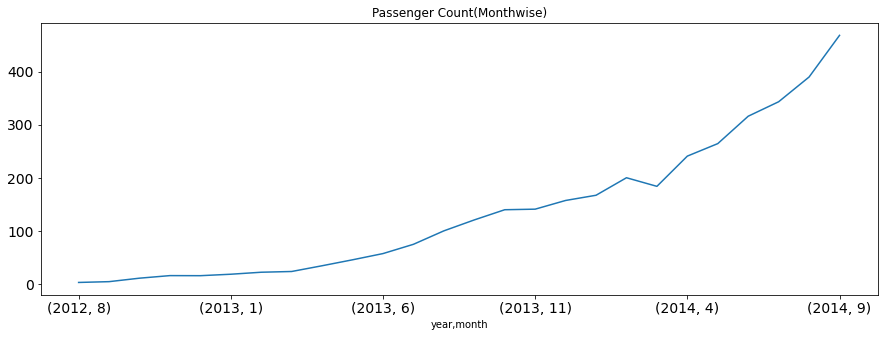

In [ ]:
temp=train.groupby(['year', 'month'])['Count'].mean() 
temp.plot(figsize=(15,5), title= 'Passenger Count(Monthwise)', fontsize=14)

- Vemos que os meses 10, 11 e 12 não estão presentes para o ano de 2014 e o valor médio desses meses no ano de 2012 é significativamente menor.
- Como há uma tendência crescente em nossa série temporal, o valor médio para o restante dos meses será maior por conta de sua maior contagem de passageiros no ano de 2014 e obteremos um valor menor para esses 3 meses.
- No gráfico de linha acima, podemos ver uma tendência crescente na contagem mensal de passageiros e o crescimento é aproximadamente exponencial.

Vejamos a média diária da contagem de passageiros.

<AxesSubplot:xlabel='day'>

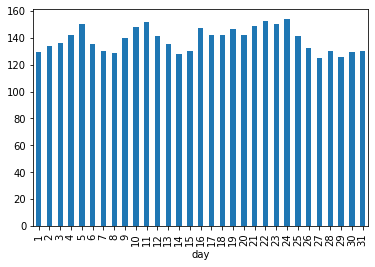

In [ ]:
train.groupby('day')['Count'].mean().plot.bar()

Não estamos obtendo muitos insights da contagem diária dos passageiros. Também levantamos a hipótese de que o tráfego será maior nos horários de pico. Então, vamos ver a contagem média de passageiros por hora.

<AxesSubplot:xlabel='Hour'>

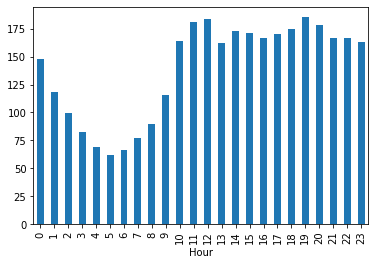

In [ ]:
train.groupby('Hour')['Count'].mean().plot.bar()

- Pode-se inferir que o pico de tráfego é às 19h e então vemos uma tendência decrescente até as 5h.
- Depois disso, a contagem de passageiros começa a aumentar novamente e atinge o pico novamente entre 11h e 12h.

Vamos tentar validar nossa hipótese em que assumimos que o tráfego será maior em dias de semana.

<AxesSubplot:xlabel='weekend'>

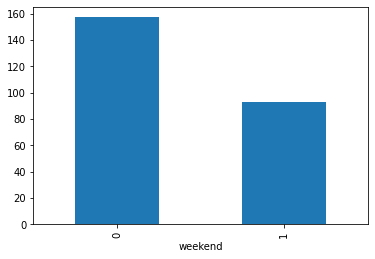

In [ ]:
train.groupby('weekend')['Count'].mean().plot.bar()

Pode-se inferir do gráfico acima que o tráfego é maior nos dias de semana do que nos finais de semana, o que valida nossa hipótese.

Agora vamos tentar olhar para a contagem de passageiros por dia.

Nota:- 0 é o início da semana, ou seja, 0 é segunda-feira e 6 é domingo.

<AxesSubplot:xlabel='day of week'>

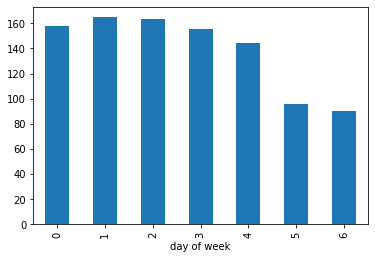

In [ ]:
train.groupby('day of week')['Count'].mean().plot.bar()

A partir do gráfico de barras acima, podemos inferir que a contagem de passageiros é menor para sábado e domingo em comparação com os outros dias da semana. Agora veremos as técnicas básicas de modelagem. Antes disso, descartaremos a variável ID, pois não tem nada a ver com a contagem de passageiros.


Como vimos que há muito ruído nas séries temporais horárias, agregaremos as séries temporais horárias em séries temporais diárias, semanais e mensais para reduzir o ruído e torná-lo mais estável e, portanto, seria mais fácil para um modelo aprender.

In [ ]:
train=train.drop('ID',1)

In [ ]:
train.Timestamp = pd.to_datetime(train.Datetime,format='%d-%m-%Y %H:%M') 
train.index = train.Timestamp 
hourly = train.resample('H').mean() 
daily = train.resample('D').mean() 
weekly = train.resample('W').mean() 
monthly = train.resample('M').mean()

Vejamos as séries temporais horárias, diárias, semanais e mensais.

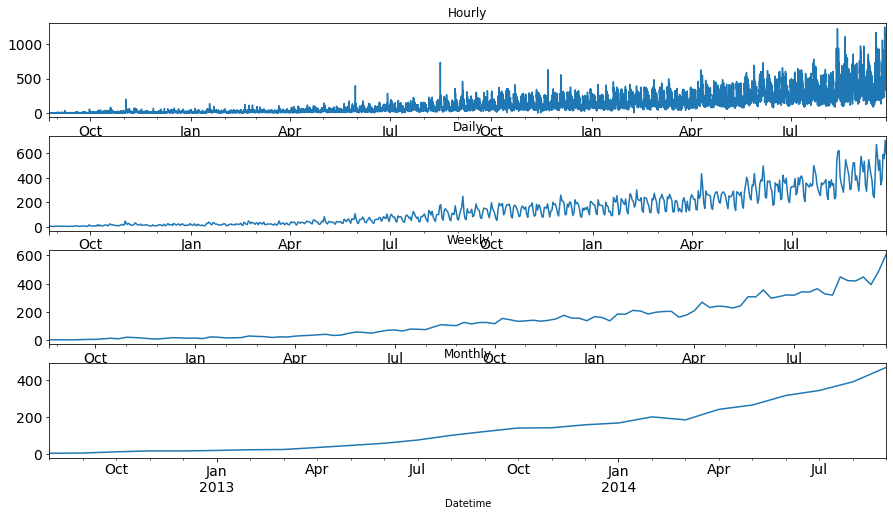

In [ ]:
fig, axs = plt.subplots(4,1) 
hourly.Count.plot(figsize=(15,8), title= 'Hourly', fontsize=14, ax=axs[0])
daily.Count.plot(figsize=(15,8), title= 'Daily', fontsize=14, ax=axs[1])
weekly.Count.plot(figsize=(15,8), title= 'Weekly', fontsize=14, ax=axs[2]) 
monthly.Count.plot(figsize=(15,8), title= 'Monthly', fontsize=14, ax=axs[3]) 
plt.show()

Podemos ver que a série temporal está se tornando cada vez mais estável quando a agregamos diariamente, semanalmente e mensalmente.

Mas seria difícil converter as previsões mensais e semanais em previsões horárias, pois primeiro temos que converter as previsões mensais em semanais, semanais em diárias e diárias em previsões horárias, o que se tornará um processo muito expandido. Então, vamos trabalhar na série temporal diária.